In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'lsay-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F5181295%2F8650027%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240905%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240905T111315Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D1b9196d7ddb33bead57c7c7598b358e9a4ab3215846a8ffdcec8fe4e0ffb73f18a8531f43b52ab85e91990f1da73f066f84ea565518c145855c7d58803aab73b966f58e3caf5ed779f1cb3eb2d3389eb9951795c8238a7ba11e73e5434ac947545ce05d9eacc94a9ec52d53bcaf035583d8c75da69ff1616efe97adbbfdbfb92a8ef4daa7348710fa5c0149040a230e74729c7bbec034e7f118cbb0d80aa94d46150d28d886c6614e5466704dff28be40c76f0e465796ede9416486a36a58dc91be77716520f4aa7456e518ed05e3bde40dcd18b2293b6c99d6d3b44f8e4cbc3ada897850082b55a863190e51d2c46f683aab69ade87a591ebce29f4b4e17832'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 21037645 bytes downloaded
Downloaded and uncompressed: lsay-dataset
Data source import complete.


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/lsay-dataset/30263-0001-Data.csv


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Load the dataset
df = pd.read_csv('/kaggle/input/lsay-dataset/30263-0001-Data.csv')
# Define fall and spring variables for 12th grade
fall_variables = [
    'KAMTH1C', 'KAMTH1D', 'KAMTH2C', 'KAMTH2D', 'KASCI1C', 'KASCI1D',
    'KASCI2C', 'KASCI2D', 'KAENG1C', 'KAENG1D', 'KAENG2C', 'KAENG2D',
    'KASSTC', 'KASSTD', 'KACOMC', 'KACOMD', 'KAFORC', 'KAFORD', 'KAARTC',
    'KAARTD', 'KAMUSC', 'KAMUSD', 'KAVOCC', 'KAVOCD', 'KA20', 'KA29ATXT',
    'KA30', 'KA46B', 'KA46D', 'KA47A', 'KA47B', 'KA47J'
]

spring_variables = [
    'LAMTH1C', 'LAMTH1D', 'LAMTH2C', 'LAMTH2D', 'LASCI1C', 'LASCI1D',
    'LASCI2C', 'LASCI2D', 'LAENG1C', 'LAENG1D', 'LAENG2C', 'LAENG2D',
    'LASSTC', 'LASSTD', 'LACOMC', 'LACOMD', 'LAFORC', 'LAARTC', 'LAMUSC',
    'LAVOCC', 'LA7M', 'LA9ATXT', 'LA10', 'LM35'
]


In [ ]:
# Encode categorical variables
label_encoder = LabelEncoder()
for col in fall_variables + spring_variables + ['LAMAJOR8I']:
    df[col] = label_encoder.fit_transform(df[col].astype(str))

In [ ]:
# Split into features and target variable
X_fall = df[fall_variables]
y_fall = df['LAMAJOR8I']  # Target variable

X_spring = df[spring_variables]
y_spring = df['LAMAJOR8I']  # Target variable

In [ ]:
# Standardize the features
scaler = StandardScaler()
X_fall = scaler.fit_transform(X_fall)
X_spring = scaler.fit_transform(X_spring)

# Train-test split
X_fall_train, X_fall_test, y_fall_train, y_fall_test = train_test_split(X_fall, y_fall, test_size=0.3, random_state=42)
X_spring_train, X_spring_test, y_spring_train, y_spring_test = train_test_split(X_spring, y_spring, test_size=0.3, random_state=42)


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, roc_auc_score
from sklearn.preprocessing import label_binarize
# Train Random Forest for Fall Semester
model_fall = RandomForestClassifier(random_state=42)
model_fall.fit(X_fall_train, y_fall_train)

# Train Random Forest for Spring Semester
model_spring = RandomForestClassifier(random_state=42)
model_spring.fit(X_spring_train, y_spring_train)

RandomForestClassifier(random_state=42)

In [ ]:
# Evaluate Fall Semester
y_fall_pred = model_fall.predict(X_fall_test)
print("Fall Semester Classification Report")
print(classification_report(y_fall_test, y_fall_pred))

Fall Semester Classification Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.68      0.88      0.77       862
           2       0.35      0.24      0.28        51
           3       0.45      0.37      0.41       177
           4       0.00      0.00      0.00        10
           5       0.52      0.24      0.33        67
           6       0.00      0.00      0.00         9
           7       0.36      0.34      0.35        79
           8       0.49      0.30      0.37        86
           9       0.67      0.38      0.49       112
          10       0.70      0.68      0.69       219
          11       0.38      0.20      0.26       109

    accuracy                           0.63      1784
   macro avg       0.38      0.30      0.33      1784
weighted avg       0.60      0.63      0.60      1784



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


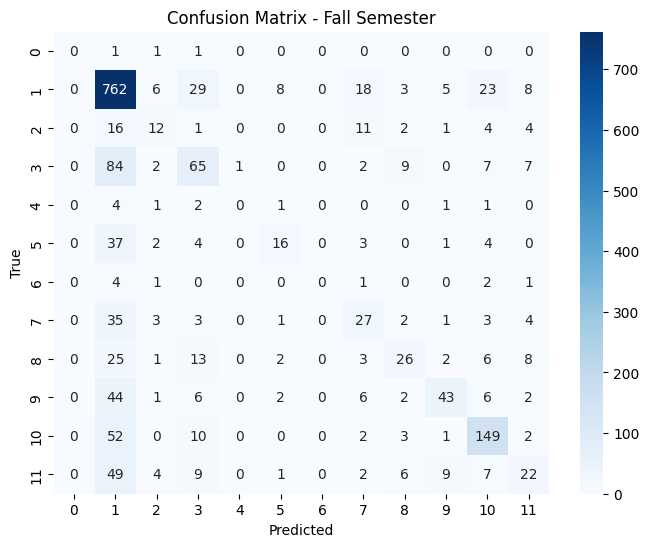

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Confusion Matrix for Fall
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_fall_test, y_fall_pred), annot=True, fmt="d", cmap="Blues")
plt.title('Confusion Matrix - Fall Semester')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [ ]:
# Evaluate Spring Semester
y_spring_pred = model_spring.predict(X_spring_test)
print("Spring Semester Classification Report")
print(classification_report(y_spring_test, y_spring_pred))

Spring Semester Classification Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.59      0.87      0.70       862
           2       0.09      0.06      0.07        51
           3       0.14      0.06      0.08       177
           4       0.00      0.00      0.00        10
           5       0.35      0.13      0.19        67
           6       0.00      0.00      0.00         9
           7       0.22      0.14      0.17        79
           8       0.23      0.06      0.09        86
           9       0.27      0.12      0.17       112
          10       0.41      0.39      0.40       219
          11       0.24      0.10      0.14       109

    accuracy                           0.50      1784
   macro avg       0.21      0.16      0.17      1784
weighted avg       0.42      0.50      0.44      1784



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


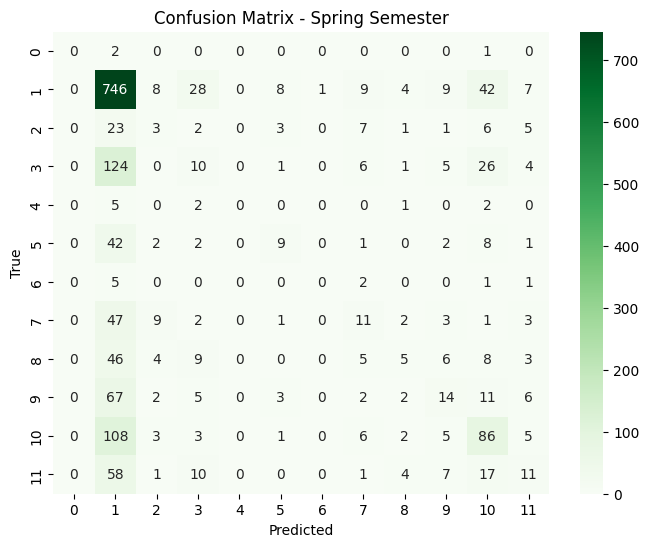

In [ ]:
# Confusion Matrix for Spring
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix(y_spring_test, y_spring_pred), annot=True, fmt="d", cmap="Greens")
plt.title('Confusion Matrix - Spring Semester')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


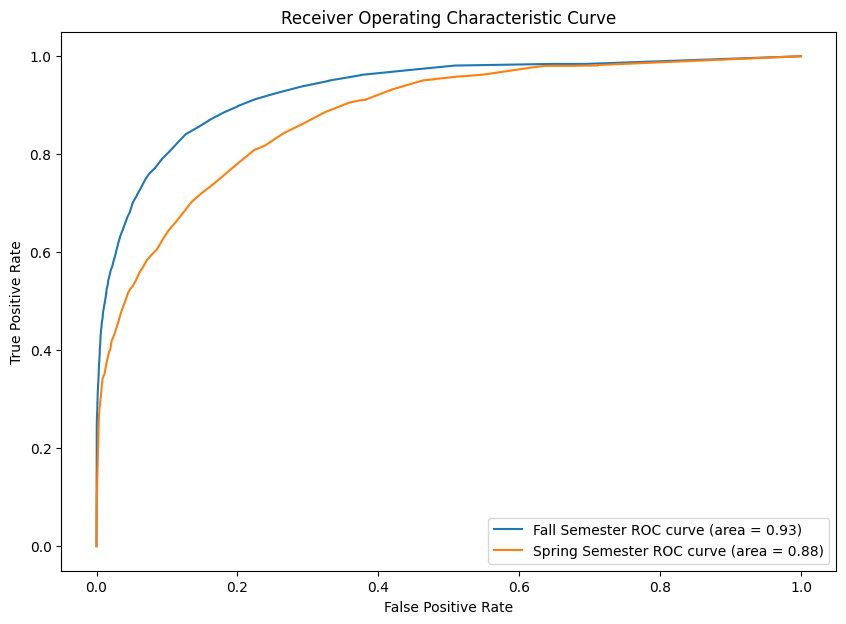

In [ ]:

# ROC Curves
y_fall_prob = model_fall.predict_proba(X_fall_test)
y_spring_prob = model_spring.predict_proba(X_spring_test)

y_fall_test_bin = label_binarize(y_fall_test, classes=np.unique(y_fall))
y_spring_test_bin = label_binarize(y_spring_test, classes=np.unique(y_spring))

fpr_fall, tpr_fall, _ = roc_curve(y_fall_test_bin.ravel(), y_fall_prob.ravel())
fpr_spring, tpr_spring, _ = roc_curve(y_spring_test_bin.ravel(), y_spring_prob.ravel())

plt.figure(figsize=(10, 7))
plt.plot(fpr_fall, tpr_fall, label='Fall Semester ROC curve (area = %0.2f)' % auc(fpr_fall, tpr_fall))
plt.plot(fpr_spring, tpr_spring, label='Spring Semester ROC curve (area = %0.2f)' % auc(fpr_spring, tpr_spring))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curve')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Feature Importance
importances_fall = model_fall.feature_importances_
importances_spring = model_spring.feature_importances_

# Sort features by importance
indices_fall = np.argsort(importances_fall)[::-1]
indices_spring = np.argsort(importances_spring)[::-1]

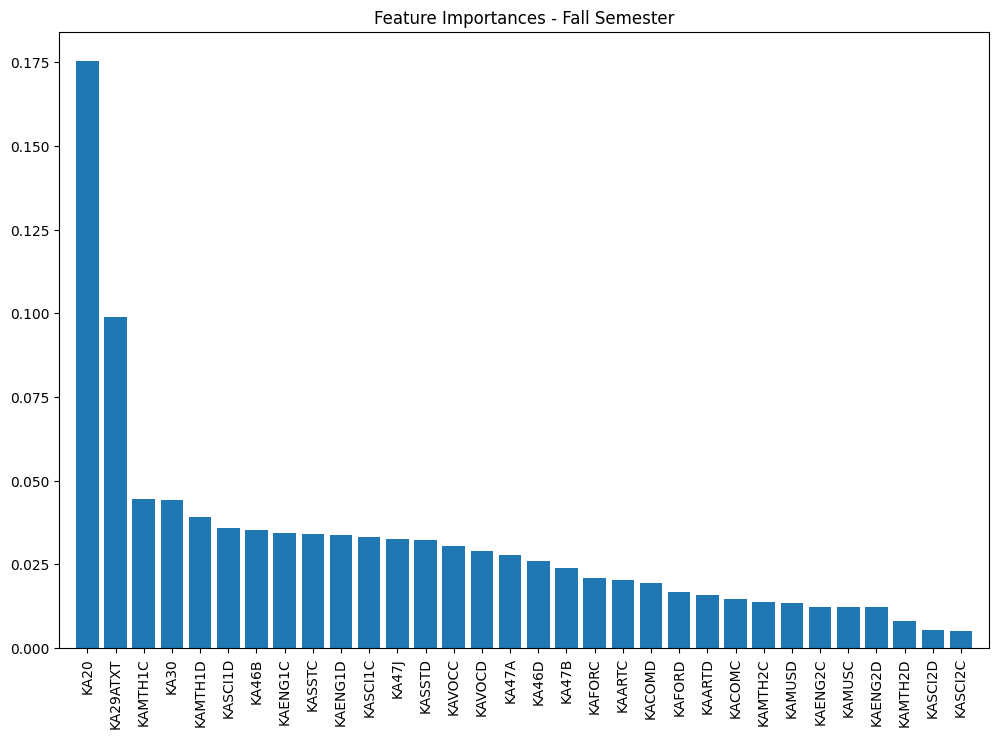

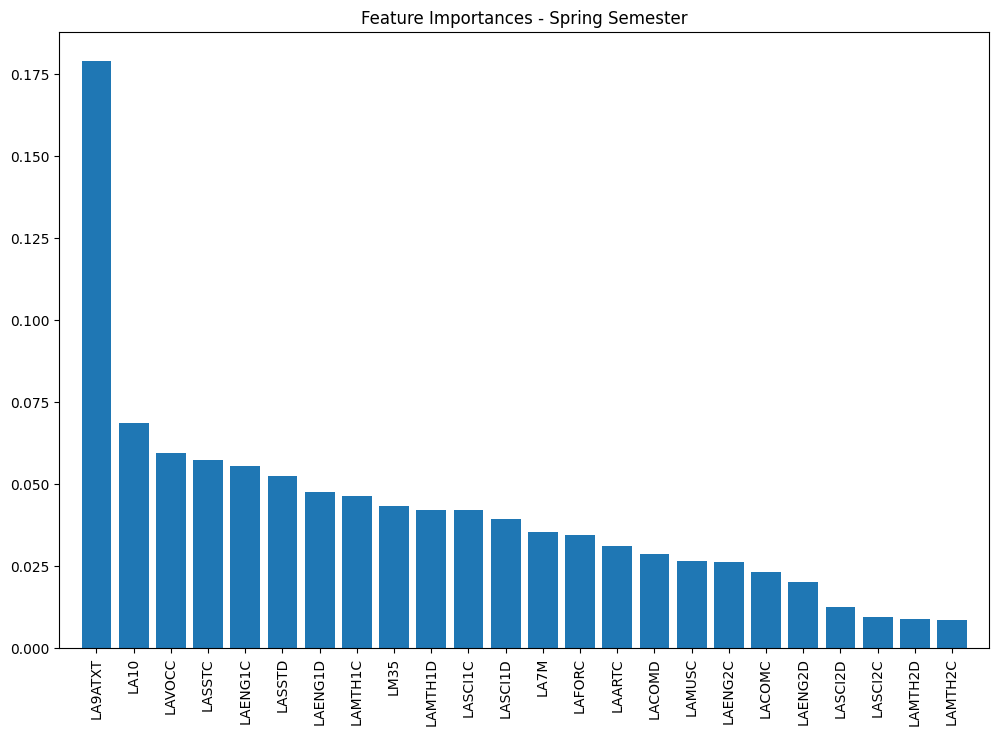

In [ ]:
# Plot feature importances for Fall Semester
plt.figure(figsize=(12, 8))
plt.title('Feature Importances - Fall Semester')
plt.bar(range(X_fall.shape[1]), importances_fall[indices_fall], align='center')
plt.xticks(range(X_fall.shape[1]), [fall_variables[i] for i in indices_fall], rotation=90)
plt.xlim([-1, X_fall.shape[1]])
plt.show()

# Plot feature importances for Spring Semester
plt.figure(figsize=(12, 8))
plt.title('Feature Importances - Spring Semester')
plt.bar(range(X_spring.shape[1]), importances_spring[indices_spring], align='center')
plt.xticks(range(X_spring.shape[1]), [spring_variables[i] for i in indices_spring], rotation=90)
plt.xlim([-1, X_spring.shape[1]])
plt.show()

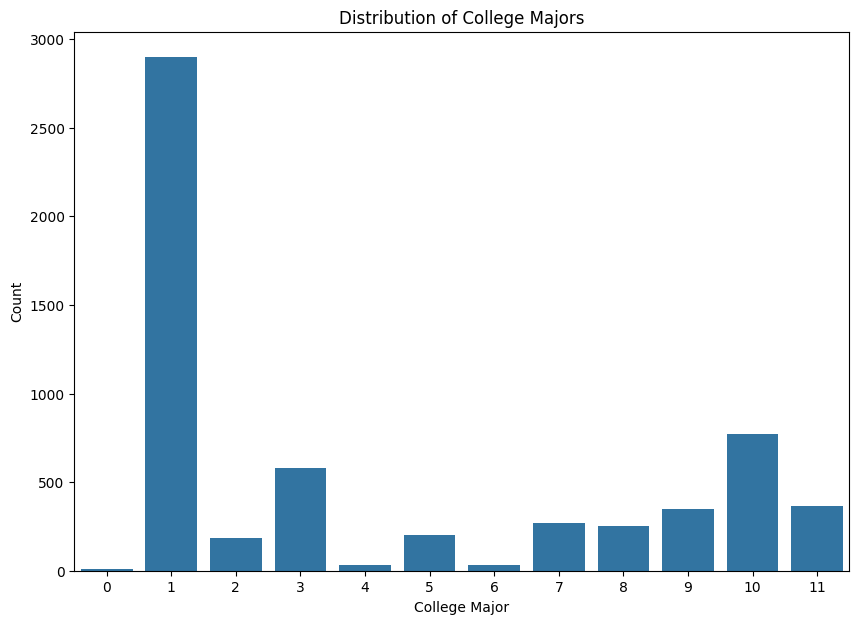

In [ ]:
# Target Variable Distribution
plt.figure(figsize=(10, 7))
sns.countplot(x='LAMAJOR8I', data=df)
plt.xlabel('College Major')
plt.ylabel('Count')
plt.title('Distribution of College Majors')
plt.show()

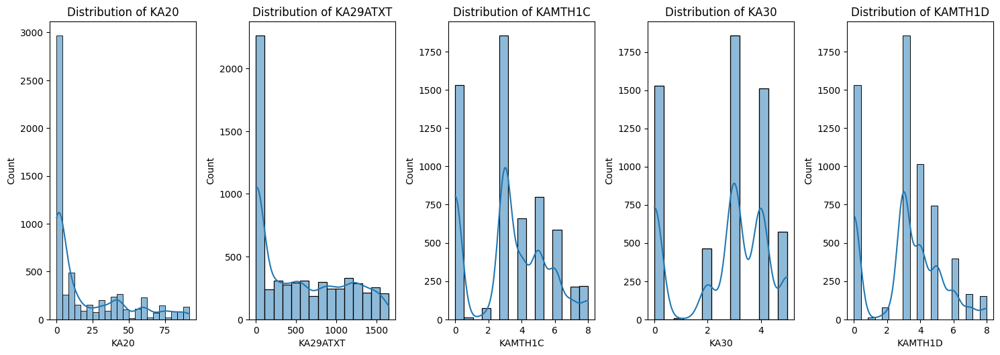

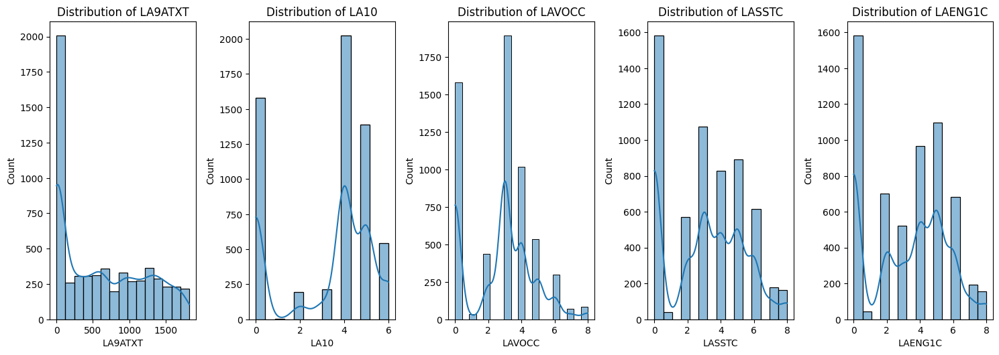

In [ ]:
# Feature Distributions for Important Features
important_fall_features = [fall_variables[i] for i in indices_fall[:5]]  # Top 5 important features
important_spring_features = [spring_variables[i] for i in indices_spring[:5]]  # Top 5 important features

plt.figure(figsize=(15, 10))
for i, feature in enumerate(important_fall_features):
    plt.subplot(2, 5, i + 1)
    sns.histplot(df[feature], kde=True)
    plt.title(f'Distribution of {feature}')
plt.tight_layout()
plt.show()

plt.figure(figsize=(15, 10))
for i, feature in enumerate(important_spring_features):
    plt.subplot(2, 5, i + 1)
    sns.histplot(df[feature], kde=True)
    plt.title(f'Distribution of {feature}')
plt.tight_layout()
plt.show()

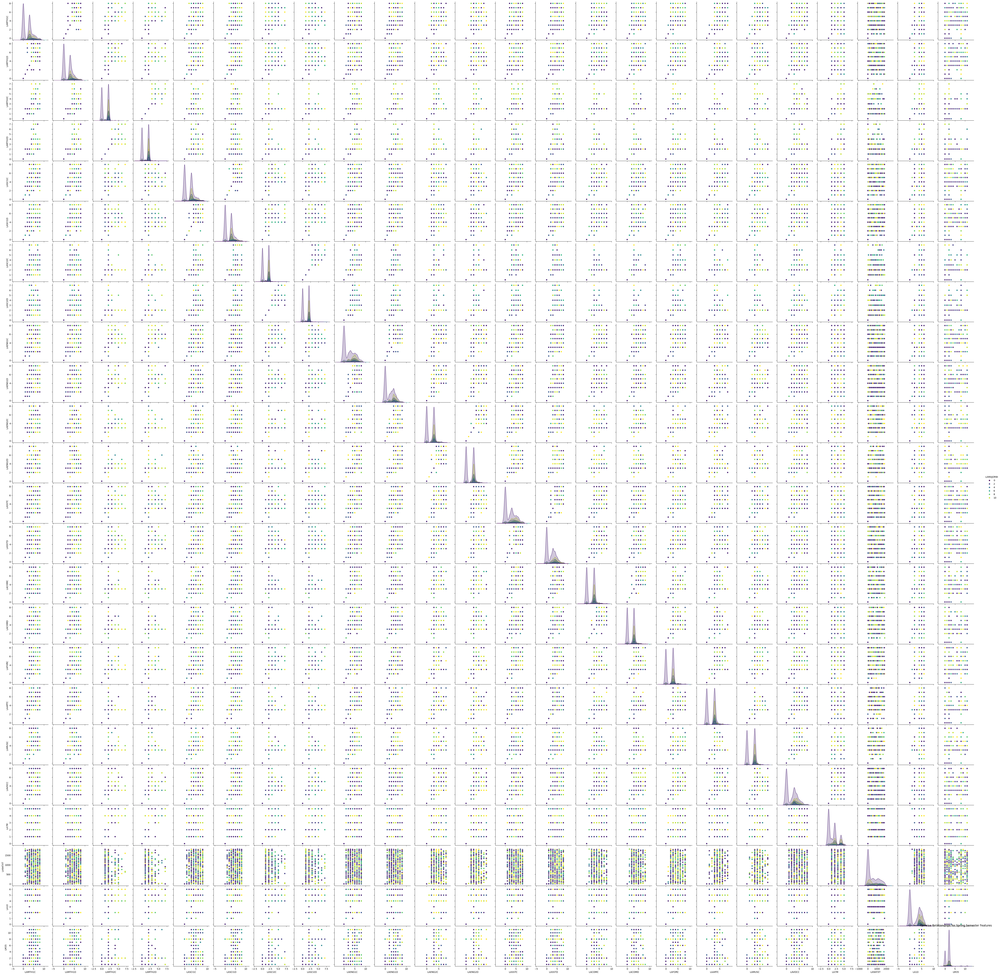

In [ ]:
# Pairwise Relationships
sns.pairplot(df[fall_variables + ['LAMAJOR8I']], hue='LAMAJOR8I', palette='viridis')
plt.title('Pairwise Relationships for Fall Semester Features')
plt.show()

sns.pairplot(df[spring_variables + ['LAMAJOR8I']], hue='LAMAJOR8I', palette='viridis')
plt.title('Pairwise Relationships for Spring Semester Features')
plt.show()


In [20]:
# Check existing columns
print(df.columns)

# If 'LAMAJOR8I' is the column to be encoded
if 'LAMAJOR8I' in df.columns:
    # Example encoding logic
    df['LAMAJOR8I_encoded'] = df['LAMAJOR8I'].astype('category').cat.codes

    # Verify the new column
    print(df.head())
else:
    print("Column 'LAMAJOR8I' does not exist in the DataFrame.")


Index(['CASENUM', 'COHORT', 'SCHOOLID', 'STRATA', 'ASCICLS', 'ASCITCH',
       'ASTSEX', 'AMTHCLS', 'AMTHTCH', 'AMTSEX',
       ...
       'PEDUC3', 'MEDSRCE', 'FEDSRCE', 'MOTHOCC', 'FATHOCC', 'POCI',
       'FOCCSRCE', 'MOCCSRCE', 'MOTHSEI', 'FATHSEI'],
      dtype='object', length=11904)
   CASENUM  COHORT  SCHOOLID  STRATA  ASCICLS  ASCITCH  ASTSEX  AMTHCLS  \
0     1001       1       309       6      -95      -95     -95      -95   
1     1002       2       132      11   132032    13203       1   132061   
2     1003       1       309       6      -95      -95     -95      -95   
3     1004       2       126       8   126026    12602       2   126101   
4     1005       2       133      11      -99      -99     -99   133024   

   AMTHTCH  AMTSEX  ...  MEDSRCE  FEDSRCE  MOTHOCC  FATHOCC  POCI  FOCCSRCE  \
0      -95     -95  ...        2        3      395      785     0         5   
1    13206       2  ...        7        7      -99      -99   -99       -99   
2      -95     -95  .

In [21]:
print(df[['LAMAJOR8I_encoded', 'GA6A']].head())
print(df[['LAMAJOR8I_encoded', 'GA6A']].describe())


   LAMAJOR8I_encoded  GA6A
0                  1     3
1                  1     3
2                 10     3
3                  1   -95
4                  7     3
       LAMAJOR8I_encoded         GA6A
count        5945.000000  5945.000000
mean            4.227586   -10.620353
std             3.856508    33.937344
min             0.000000   -98.000000
25%             1.000000     3.000000
50%             2.000000     3.000000
75%             9.000000     3.000000
max            11.000000     3.000000


<ipython-input-22-6560473de960>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='LAMAJOR8I_encoded', y='GA6A', data=df, palette='Set2')


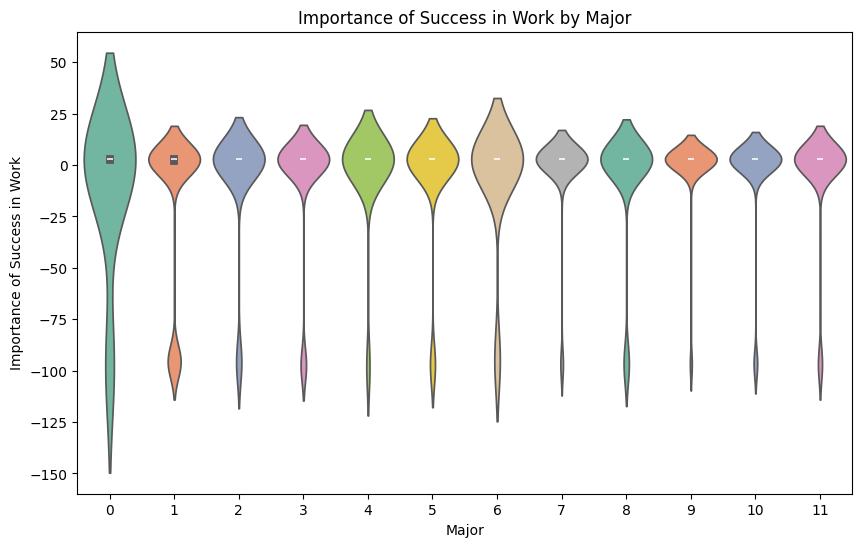

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.violinplot(x='LAMAJOR8I_encoded', y='GA6A', data=df, palette='Set2')
plt.title('Importance of Success in Work by Major')
plt.xlabel('Major')
plt.ylabel('Importance of Success in Work')
plt.show()
